# Intervention Dauphine - Finance Quantitative - 25 mars 2021

## 1 - Import des librairies nécessaires

In [1]:
import os
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import numpy as np
from datetime import date, datetime
from time import time
dateparse = lambda x: datetime.strptime(x, '%d/%m/%Y')

from IPython.display import display
from matplotlib import pyplot as plt

import plotly.offline as pyo
import plotly.graph_objs as go
pyo.init_notebook_mode()

from sklearn.model_selection import train_test_split


from aeqlib import viz, quantlib, lisa

FOLDER = 'data'

In [2]:
exx = pd.read_csv(
    f'{FOLDER}/stoxx50.csv',
    header=0, index_col=0, sep=';',
    parse_dates=True, date_parser=dateparse)

In [3]:
exx

,OR FP Equity,DG FP Equity,SAN SQ Equity,ASML NA Equity,PHIA NA Equity,FP FP Equity,AI FP Equity,CS FP Equity,BNP FP Equity,BN FP Equity,...,SAP GY Equity,RI FP Equity,ADS GY Equity,DTE GY Equity,DPW GY Equity,DAI GY Equity,DB1 GY Equity,VNA GY Equity,SX5T Index,SXXP Index
Dates,,,,,,,,,,,,,,,,,,,,,
2005-01-03,56.450,24.594,8.085,11.860,19.357,39.624,35.179,17.635,51.786,32.555,...,32.895,43.614,30.230,16.710,17.270,35.680,22.325,NaN,4063.340,252.550
2005-01-04,56.900,24.840,8.085,11.640,19.063,39.476,35.179,17.549,52.123,32.743,...,32.250,43.729,30.075,16.840,17.060,36.050,22.400,NaN,4064.830,253.550
2005-01-05,56.950,24.741,7.971,11.310,18.681,39.106,34.792,17.319,51.834,32.507,...,32.050,43.999,29.700,16.700,17.000,35.920,22.300,NaN,4032.100,251.850
2005-01-06,57.300,25.085,7.971,11.290,18.671,39.402,34.895,17.444,52.605,32.672,...,32.675,43.845,29.838,16.710,17.050,36.110,22.370,NaN,4058.170,253.090
2005-01-07,57.850,25.208,7.936,11.240,18.622,39.526,35.127,17.568,53.232,32.956,...,33.335,43.999,29.663,16.780,17.150,35.930,22.300,NaN,4076.730,254.720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-01-22,296.300,80.460,2.581,462.900,45.635,36.220,132.050,19.212,43.085,54.560,...,104.700,153.100,278.000,15.065,42.820,59.070,132.900,55.060,7812.310,408.540
2021-01-25,299.000,78.720,2.490,461.350,46.690,35.350,131.400,18.770,41.230,54.700,...,105.520,151.950,269.000,14.920,42.220,57.440,133.000,55.860,7705.460,405.130
2021-01-26,301.800,77.980,2.533,458.550,47.235,35.980,134.950,18.856,41.990,55.380,...,109.980,153.900,276.700,14.990,42.960,58.890,134.450,55.760,7791.520,407.700


## 2 - Stratégie quantitative simple

### Définition de la moyenne mobile simple - Simple Moving Average (SMA) - $SMA_{n, t} = \frac{1}{n}\sum_{0}^{n-1} P_{t-i}$

In [4]:
def moving_average(s, window=10):
    return(s.rolling(window=window).mean())

In [5]:
def crossing_sma_strategy(s, w1, w2, shift=0):
    sma1 = moving_average(s, w1)
    sma2 = moving_average(s, w2)
    signal = np.sign(sma1 - sma2).diff() / 2
    signal = signal.shift(shift)
    signal = signal.replace(0, np.nan)
    signal.iloc[0] = 1
    signal = signal.pad()
    return(signal)

In [6]:
asset = exx['SX5T Index']

In [7]:
s = asset.copy()
w1 = 200
w2 = 500

sma1 = moving_average(s, w1)
sma2 = moving_average(s, w2)
signal = np.sign(sma1 - sma2).diff() / 2

In [8]:
# example of strategy with 200 and 500
sig = crossing_sma_strategy(asset, 200, 500)
strat = (sig * asset.pct_change().fillna(0) + 1).cumprod() * asset.iloc[0]

# plot
name = asset.name
all_windows = [1, 5, 10, 12, 50, 100, 200, 500]
df = pd.concat([moving_average(asset, w) for w in all_windows], axis=1)
df.columns = [f'{name}_SMA_{w}' for w in all_windows]
fig = viz.easy_plot(pd.concat([df, strat], axis=1), show=False)

In [9]:
fig.show()

In [10]:
def sma_strategy_wrapper(s, w1, w2, fees=0.0005, shift=2):
    sig = crossing_sma_strategy(s, w1, w2, shift=shift)
    strat = (sig * s.pct_change().fillna(0) - abs(sig.diff().fillna(0)) * fees + 1).cumprod() * s.iloc[0]
    return strat.iloc[-1] / strat.iloc[0] - 1

## Grid-search avec échantillonnage aléatoire

### Test sans fees ni shift, puis avec fees, puis avec shift

In [11]:
from itertools import product
m = range(1, 501)

for func in [
    lambda w: sma_strategy_wrapper(asset, w[0], w[1], fees=0, shift=0),
    lambda w: sma_strategy_wrapper(asset, w[0], w[1], fees=0.0005, shift=0),
    lambda w: sma_strategy_wrapper(asset, w[0], w[1], fees=0, shift=2),
    lambda w: sma_strategy_wrapper(asset, w[0], w[1], fees=0.0005, shift=2),
]:
    grid = pd.DataFrame(product(m, m)).sample(frac = 0.01, random_state=3)
    grid = grid.sort_index()
    t1 = time()
    grid['results'] = grid.apply(
        func,
        axis=1)
    t2 = time()
    print(t2 - t1)

    display(grid.sort_values(by='results'))

14.747560262680054


,0,1,results
5000,11,1,-1.000
32000,65,1,-1.000
92000,185,1,-0.992
124500,250,1,-0.992
137500,276,1,-0.985
...,...,...,...
1516,4,17,27.731
309,1,310,27.927
2006,5,7,39.985
251,1,252,85.900


11.619581937789917


,0,1,results
5000,11,1,-1.000
32000,65,1,-1.000
124500,250,1,-0.993
92000,185,1,-0.993
137500,276,1,-0.987
...,...,...,...
339,1,340,21.689
338,1,339,22.711
309,1,310,24.857
251,1,252,73.531


10.17225193977356


,0,1,results
14536,30,37,-0.855
7,1,8,-0.850
5065,11,66,-0.839
236495,473,496,-0.838
214996,430,497,-0.834
...,...,...,...
249953,500,454,2.246
216814,434,315,2.315
217314,435,315,2.351
248441,497,442,2.636


10.679455995559692


,0,1,results
7,1,8,-0.936
2006,5,7,-0.880
14536,30,37,-0.876
5065,11,66,-0.854
236495,473,496,-0.842
...,...,...,...
249953,500,454,2.198
216814,434,315,2.289
217314,435,315,2.324
248441,497,442,2.582


In [12]:
print(sma_strategy_wrapper(asset, 1, 8, fees=0.0, shift=0))
print(sma_strategy_wrapper(asset, 1, 8, fees=0.0005, shift=2))

5661766894.087999
-0.9358196371136654


In [13]:
grid['results'].describe(percentiles=np.linspace(0, 1, 11))

count   2500.000
mean       0.025
std        0.501
min       -0.936
0%        -0.936
10%       -0.518
20%       -0.423
30%       -0.326
40%       -0.230
50%       -0.105
60%        0.078
70%        0.280
80%        0.466
90%        0.713
100%       3.150
max        3.150
Name: results, dtype: float64

In [14]:
grid.sort_values('results')

,0,1,results
7,1,8,-0.936
2006,5,7,-0.880
14536,30,37,-0.876
5065,11,66,-0.854
236495,473,496,-0.842
...,...,...,...
249953,500,454,2.198
216814,434,315,2.289
217314,435,315,2.324
248441,497,442,2.582


In [15]:
tol = 20
grid.loc[(abs(grid[0] - 499) < tol) & (abs(grid[1]-440) < tol)]

,0,1,results
240450,481,451,0.821
242439,485,440,1.710
242446,485,447,0.447
243924,488,425,2.121
244922,490,423,1.984
244954,490,455,0.742
246950,494,451,1.433
246957,494,458,1.553
247422,495,423,1.649
248441,497,442,2.582


En séparant échantillon de test d'échantillon d'apprentissage...

In [16]:
def optimize(asset, w_min, w_max):
    
    train, test = train_test_split(asset, test_size=0.2, shuffle=False)
    
    m = range(w_min, w_max+1)
    grid = pd.DataFrame(product(m, m)).sample(frac = 0.01, random_state=3)
    grid = grid.sort_index()
    grid['results'] = grid.apply(lambda w: sma_strategy_wrapper(train, w[0], w[1], fees=0.0005, shift=2), axis=1)
    best = grid.sort_values('results', ascending=False).iloc[0,:]
    w0, w1, IS_results = best
    print(w0)
    print(w1)
    complete_result = sma_strategy_wrapper(asset, int(w0), int(w1))
    return grid, IS_results, complete_result
    

In [17]:
grid, IS, complete = optimize(asset, 5, 500)

52.0
143.0


In [18]:
# example of strategy with 200 and 500
w1 = 52
w2 = 143
shift=2
fees = 0.0005

sig = crossing_sma_strategy(s, w1, w2, shift=shift)
strat = (sig * s.pct_change().fillna(0) - abs(sig.diff().fillna(0)) * fees + 1).cumprod() * s.iloc[0]
train, test = train_test_split(s, test_size=0.2, shuffle=False)

# plot
name = asset.name
all_windows = [1, 52, 143]
df = pd.concat([moving_average(asset, w) for w in all_windows], axis=1)
df.columns = [f'{name}_SMA_{w}' for w in all_windows]
fig = viz.easy_plot(pd.concat([df, strat], axis=1), show=False)
fig.add_vline(x = train.index[-1])
fig.show()

## 3 - Application du Machine-Learning : clustering

In [19]:
def identity(stock, benchmark='SX5T Index'):
    bmk = exx[benchmark]
    stock_clean = stock.pct_change().dropna()
    bmk_clean = bmk.pct_change().dropna()
    
    stock_1y = stock_clean.tail(252)
    stock_3y = stock_clean.tail(3 * 252)
    
    bmk_1y = bmk_clean.reindex(index = stock_1y.index)
    bmk_3y = bmk_clean.reindex(index = stock_3y.index)
    
    ids = []
    for w, stock_, bmk_ in zip([1, 3], [stock_1y, stock_3y], [bmk_1y, bmk_3y]):
        perf = quantlib.annualized_return(stock_)
        vol = quantlib.volatility(stock_)
        sharpe = quantlib.sharpe_corrected(stock_)
        semi_vol = quantlib.semi_volatility(stock_)
        sortino = quantlib.sortino_corrected(stock_)
        calmar = quantlib.calmar_corrected(stock_)
        mdd = quantlib.max_draw_down(stock_)
        var = quantlib.value_at_risk(stock_.to_frame()).iloc[0]
        cvar = quantlib.expected_shortfall(stock_.to_frame()).iloc[0]
        tracking = quantlib.tracking_error(pd.concat([stock_, bmk_], axis=1), stock_.name, bmk_.name)
        information = quantlib.information_ratio(pd.concat([stock_, bmk_], axis=1), stock_.name, bmk_.name)
        beta = quantlib.beta_ptf(pd.concat([stock_, bmk_], axis=1), stock_.name, bmk_.name)
        alpha = quantlib.alpha_ptf(pd.concat([stock_, bmk_], axis=1), stock_.name, bmk_.name)
        up_days = quantlib.up_days_ptf(pd.concat([stock_, bmk_], axis=1), stock_.name, bmk_.name)
        
        identity = pd.Series({
            "perf": perf,
            "vol": vol,
            "sharpe": sharpe,
            "semi_vol": semi_vol,
            "sortino": sortino,
            "calmar": calmar,
            "mdd": mdd,
            "var": var,
            "cvar": cvar,
            "tracking": tracking,
            "information": information,
            "beta": beta,
            "alpha": alpha,
            "up_days": up_days
        })
        identity.index = [f'{ind}_{w}y' for ind in identity.index]
        ids.append(identity)

    return pd.concat(ids)

In [20]:
all_ids = exx.iloc[:, :-2].apply(identity, axis=0)

In [21]:
all_ids.T.sort_values('perf_1y')

,perf_1y,vol_1y,sharpe_1y,semi_vol_1y,sortino_1y,calmar_1y,mdd_1y,var_1y,cvar_1y,tracking_1y,...,sortino_3y,calmar_3y,mdd_3y,var_3y,cvar_3y,tracking_3y,information_3y,beta_3y,alpha_3y,up_days_3y
AIR FP Equity,-0.385,0.737,-0.284,0.681,-0.262,0.247,-0.641,-0.129,-0.176,0.556,...,-0.021,0.031,-0.647,-0.087,-0.130,0.352,-0.233,1.536,-0.000,0.451
SAN SQ Equity,-0.368,0.584,-0.215,0.552,-0.203,0.225,-0.611,-0.099,-0.131,0.387,...,-0.086,0.166,-0.724,-0.059,-0.092,0.264,-1.004,1.401,-0.001,0.430
ENI IM Equity,-0.360,0.520,-0.187,0.563,-0.203,0.198,-0.551,-0.070,-0.153,0.309,...,-0.054,0.096,-0.649,-0.058,-0.098,0.209,-0.877,1.241,-0.001,0.440
BAYN GY Equity,-0.352,0.423,-0.149,0.439,-0.155,0.169,-0.480,-0.071,-0.118,0.277,...,-0.069,0.118,-0.610,-0.051,-0.095,0.251,-0.909,1.079,-0.001,0.450
INGA NA Equity,-0.332,0.628,-0.209,0.625,-0.208,0.200,-0.603,-0.094,-0.144,0.411,...,-0.084,0.144,-0.703,-0.081,-0.109,0.277,-0.864,1.511,-0.001,0.451
SAF FP Equity,-0.288,0.712,-0.205,0.689,-0.198,0.184,-0.639,-0.151,-0.187,0.512,...,0.137,-0.093,-0.646,-0.077,-0.133,0.326,0.078,1.537,0.000,0.475
ISP IM Equity,-0.285,0.441,-0.126,0.472,-0.135,0.140,-0.493,-0.086,-0.130,0.236,...,-0.058,0.095,-0.587,-0.059,-0.097,0.221,-0.887,1.178,-0.001,0.455
AMS SQ Equity,-0.272,0.576,-0.157,0.541,-0.147,0.143,-0.524,-0.088,-0.121,0.422,...,-0.013,0.020,-0.571,-0.062,-0.089,0.280,-0.249,1.202,-0.000,0.479
CS FP Equity,-0.271,0.464,-0.126,0.438,-0.119,0.138,-0.510,-0.084,-0.125,0.241,...,-0.020,0.034,-0.510,-0.050,-0.085,0.167,-0.608,1.163,-0.000,0.459
DG FP Equity,-0.262,0.548,-0.143,0.544,-0.142,0.122,-0.466,-0.111,-0.135,0.323,...,-0.005,0.006,-0.466,-0.063,-0.102,0.211,-0.227,1.324,-0.000,0.460


In [22]:
# normalize data
all_ids = ((all_ids.T - all_ids.T.mean()) / all_ids.T.std()).T

In [23]:
infos = lisa.get_tickers(all_ids.columns)[['gics_sector_name', 'country', 'name']]

In [24]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=5, random_state=0)

In [25]:
pred = kmeans.fit_predict(all_ids.T)

In [26]:
abcd = pd.concat([infos, pd.Series(pred, index=all_ids.columns, name='cluster')], axis=1)

In [27]:
# abcd.sort_values('cluster').to_csv(f'{FOLDER}/cluster.csv', sep=';')
abcd = abcd.sort_values(['cluster', 'gics_sector_name'])
abcd.set_index('cluster', append=True)

# 0 est + proche de 2 Quali / croissance avec LVMH, ASML, OR, mais tempéré par SU et IBE…
# 1 est très financière et cyclique (pas très loin de 3)
# 2 a l'air d'être assez Quali & défensif
# 3 a l'air assez Value, avec des dépendances au secteur aérien, automobile et bancaire
# 4 outlier

,,gics_sector_name,country,name
,cluster,,,
FLTR ID Equity,0,Consumer Discretionary,IRELAND,FLUTTER ENTERTAINMENT PLC
MC FP Equity,0,Consumer Discretionary,FRANCE,LVMH MOET HENNESSY LOUIS VUI
PRX NA Equity,0,Consumer Discretionary,NETHERLANDS,PROSUS NV
OR FP Equity,0,Consumer Staples,FRANCE,L'OREAL
KNEBV FH Equity,0,Industrials,FINLAND,KONE OYJ-B
SIE GY Equity,0,Industrials,GERMANY,SIEMENS AG-REG
SU FP Equity,0,Industrials,FRANCE,SCHNEIDER ELECTRIC SE
ASML NA Equity,0,Information Technology,NETHERLANDS,ASML HOLDING NV
IBE SQ Equity,0,Utilities,SPAIN,IBERDROLA SA


In [28]:
viz.easy_plot([exx['ADYEN NA Equity']])

## Expliquons les clusters attribués : arbre de décision et forêt aléatoire

In [29]:
new_problem = pd.concat([all_ids.T, abcd['cluster']], axis=1)
X = new_problem.iloc[:,:-1]
y = new_problem.iloc[:, -1]

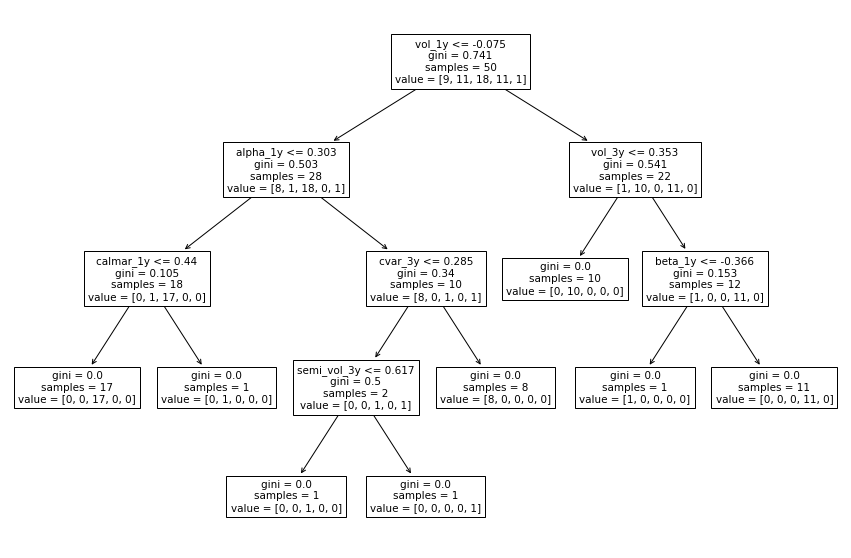

In [35]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

clf = DecisionTreeClassifier(max_leaf_nodes=8, random_state=0)
clf.fit(X, y)

tree.plot_tree(clf, feature_names=X.columns)
plt.rcParams["figure.figsize"] = (1,1)
plt.show()

Gini mesure l'impureté de la classification : $ G = 1 - \sum_1^n p_i^{2}$

In [31]:
N = 50
1 - (9/N)**2 - (11/N)**2 -(18/N)**2 -(11/N)**2 -(1/N)**2

0.7408000000000001

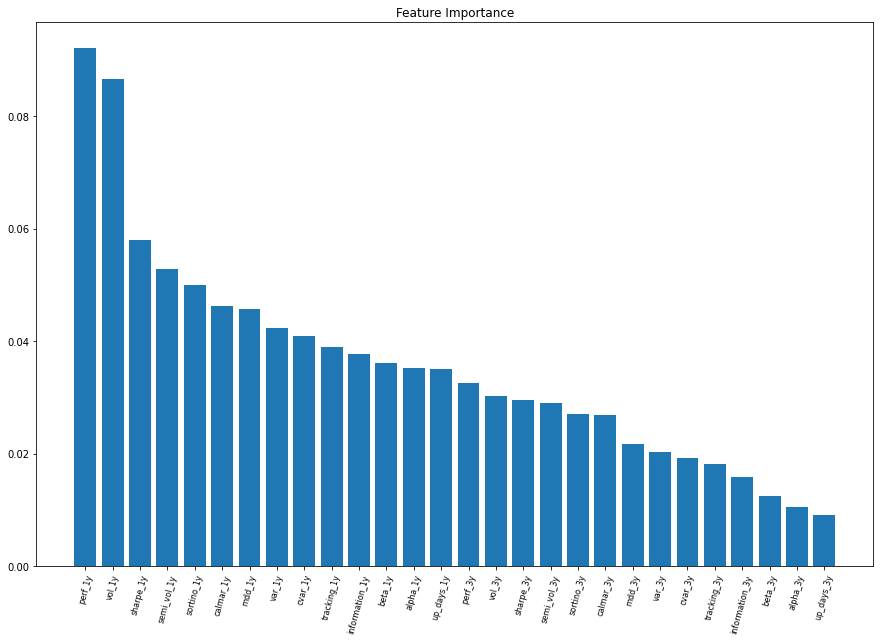

In [36]:
from sklearn.ensemble import RandomForestClassifier
from sklearn import datasets

# Create decision tree classifer object
clf = RandomForestClassifier(random_state=0, n_jobs=-1)
# Train model
model = clf.fit(X, y)

# Calculate feature importances
importances = model.feature_importances_
# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

# Rearrange feature names so they match the sorted feature importances
names = X.columns

# Barplot: Add bars
plt.bar(range(X.shape[1]), importances[indices])
# Add feature names as x-axis labels
plt.xticks(range(X.shape[1]), names, rotation=75, fontsize = 8)
# Create plot title
plt.title("Feature Importance")
plt.rcParams["figure.figsize"] = (15,10)
# Show plot
plt.show()

## 4 - La particularité des données financières

### Fortes corrélations

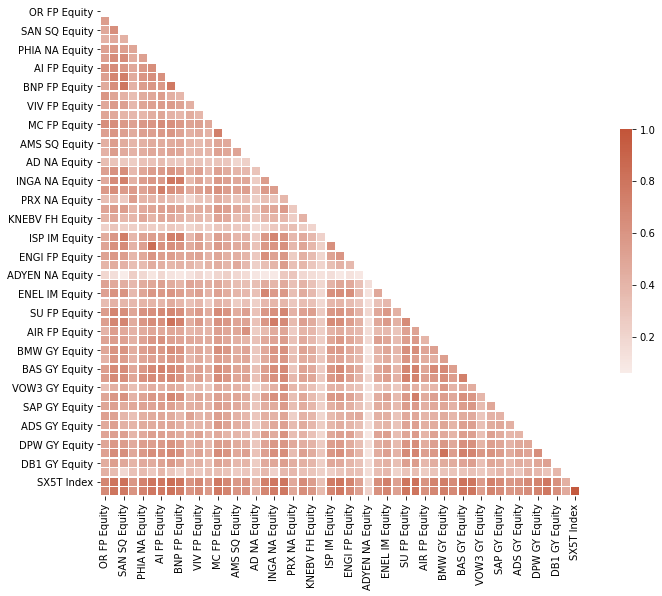

In [33]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Generate a large random dataset
d = pd.DataFrame(exx.pct_change())

# Compute the correlation matrix
corr = d.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

### Séries non stationnaires, non saisonnières, régimes de volatilité

In [34]:
viz.easy_plot(exx.pct_change())